In [1]:
%load_ext pycodestyle_magic
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer, intercluster_distance
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn import metrics
import squarify
import random
import plotly.graph_objects as go
import plotly.io as pyo

pd.options.display.max_columns = None

In [2]:
data = pd.read_csv('data_nettoyee.csv')
print(f'Le fichier data_nettoyee contient {data.shape[0]} lignes et {data.shape[1]} colonnes')

Le fichier data_nettoyee contient 115608 lignes et 40 colonnes


### Correction des types

In [3]:
liste_date = ['order_purchase_timestamp', 'order_approved_at', 'order_delivered_customer_date', 'order_estimated_delivery_date',
              'review_creation_date', 'review_answer_timestamp', 'shipping_limit_date']

for date in liste_date:
    data[date]=data[date].astype('datetime64[ns]')

## RFM

L'objectif d'une RFM est d'analyser les profils de clients selon 3 critères :  
- Recency : le nombre de jours depuis le dernier achat
- Frequency : le nombre d'achats réalisés
- Monetary : le montant total acheté par client

### Recency

In [4]:
# La référence sera la dernière date d'achat présente dans les données
max_date = max(data['order_purchase_timestamp'])
data['dernier_achat_jours'] = (max_date - data['order_purchase_timestamp']).dt.days

In [5]:
# Recency  - correspond à la date du dernier achat (délai en jours)
recency = data.groupby('customer_unique_id')['dernier_achat_jours'].min()  #.min afin d'avoir la date la plus récente par customer_unique_id
recency = recency.reset_index()
recency.columns = ['customer_unique_id', 'recency']
recency.head()

,customer_unique_id,recency
0,0000366f3b9a7992bf8c76cfdf3221e2,115
1,0000b849f77a49e4a4ce2b2a4ca5be3f,118
2,0000f46a3911fa3c0805444483337064,541
3,0000f6ccb0745a6a4b88665a16c9f078,325
4,0004aac84e0df4da2b147fca70cf8255,292


### Monetary

In [6]:
# Ajout du prix total correspondant au prix de l'article + prix du transport (attention, ne pas le faire sur 'payment_value' 
# car sinon cela somme plusieurs fois la valeur de la commande, du nombre d'articles s'y trouvant (donc pour les commandes avec plusieurs articles)
data['prix_total'] = data['price'] + data['freight_value']

In [7]:
# monetary - correspond à la somme des achats par client
monetary = data.groupby('customer_unique_id')['prix_total'].sum()
monetary = monetary.reset_index()
monetary.columns = ['customer_unique_id', 'monetary']
monetary.head()

,customer_unique_id,monetary
0,0000366f3b9a7992bf8c76cfdf3221e2,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,27.19
2,0000f46a3911fa3c0805444483337064,86.22
3,0000f6ccb0745a6a4b88665a16c9f078,43.62
4,0004aac84e0df4da2b147fca70cf8255,196.89


### Frequency

In [8]:
### Frequency - correspond au nombre d'achats réalisé par client
frequency = data.groupby('customer_unique_id')['order_id'].count()
frequency = frequency.reset_index()
frequency.columns = ['customer_unique_id', 'frequency']
frequency.head()

,customer_unique_id,frequency
0,0000366f3b9a7992bf8c76cfdf3221e2,1
1,0000b849f77a49e4a4ce2b2a4ca5be3f,1
2,0000f46a3911fa3c0805444483337064,1
3,0000f6ccb0745a6a4b88665a16c9f078,1
4,0004aac84e0df4da2b147fca70cf8255,1


In [9]:
frequency.sort_values(by='frequency', ascending=False)

,customer_unique_id,frequency
56428,9a736b248f67d166d2fbb006bcb877c3,75
40853,6fbc7cdadbb522125f4b27ae9dee4060,38
91151,f9ae226291893fda10af7965268fb7f6,35
50729,8af7ac63b2efbcbd88e5b11505e8098a,29
31698,569aa12b73b5f7edeaa6f2a01603e381,26
...,...,...
33565,5b9102c033e98918ec6bbffa97684fa0,1
33564,5b8fa14616eb4c5688b1b8b2aae75884,1
33563,5b8f3fe73552d160b27f783f51d40941,1
33562,5b8eac9117d8948bdadd22612055a8b1,1


### Analyses

In [10]:
# Regroupement en un df unique
rfm = pd.merge(recency, frequency, on='customer_unique_id')
rfm = pd.merge(rfm, monetary, on='customer_unique_id')
print(rfm.shape)
rfm.describe([0.01, 0.05, 0.1, 0.25, 0.5, 0.75, 0.9, 0.95, 0.99])

(93395, 4)


,recency,frequency,monetary
count,93395.000000,93395.000000,93395.000000
mean,241.740618,1.237839,174.115691
std,153.161518,0.847545,263.053286
min,0.000000,1.000000,10.070000
1%,13.000000,1.000000,22.840000
5%,27.000000,1.000000,32.797000
10%,45.000000,1.000000,40.690000
25%,118.000000,1.000000,64.000000
50%,222.000000,1.000000,110.440000
75%,351.000000,1.000000,189.000000


Analyse des indicateurs statistiques de base :   
- Recency : forte disparité, l'écart standart est proche de la moyenne  
- Frequency : la plupart des clients n'ont réalisé qu'un seul achat  
- Monetary : beaucoup de disparité entre les achats : min à 10.07 reals et max à 13 664.08 réals avec une moyenne à 174 réals

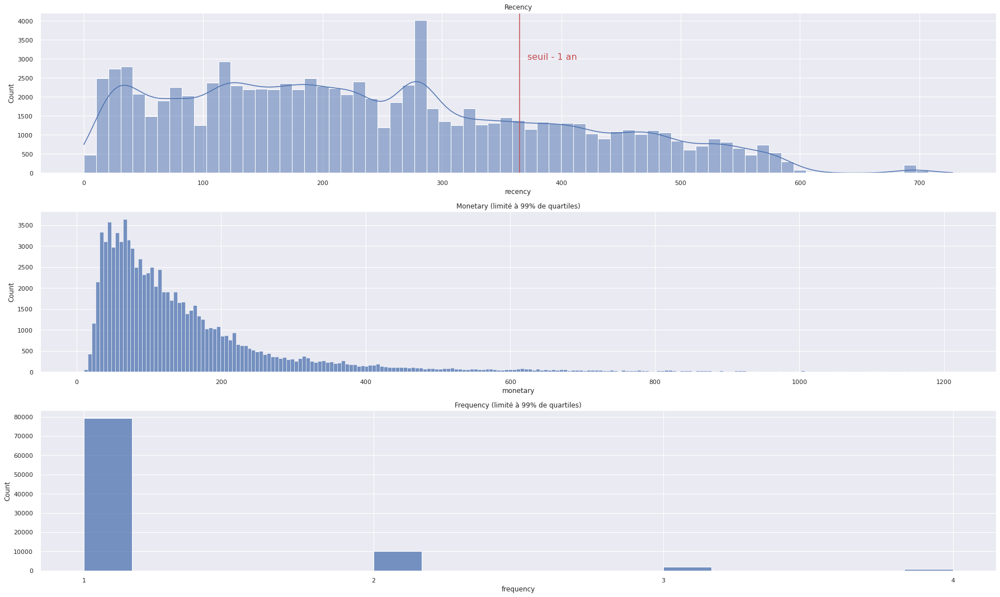

In [11]:
# Affichage des distributions avec limitation à 99% de quartiles pour frequency et monetary
sns.set()
plt.rcParams["figure.figsize"] = (25, 15)
fig, axes = plt.subplots(3)

sns.histplot(x='recency', data=rfm, kde=True, ax=axes[0])
axes[0].axvline(x=365, color='r')  # ligne verticale pour marquer la barre des 1 an
axes[0].annotate('seuil - 1 an', xy=(1, 0), xycoords='axes fraction', fontsize=16,
                 xytext=(-750, 200), textcoords='offset points', color='r',
                 ha='right', va='bottom')
axes[0].set_title('Recency')

sns.histplot(rfm['monetary'][rfm['monetary'] <= np.quantile(a=rfm.monetary, q=0.99)], ax=axes[1])
axes[1].set_title('Monetary (limité à 99% de quartiles)')


sns.histplot(rfm['frequency'][rfm['frequency'] <= np.quantile(a=rfm.frequency, q=0.99)], ax=axes[2])
axes[2].set_title('Frequency (limité à 99% de quartiles)')
axes[2].set_xticks([1, 2, 3, 4])

fig.tight_layout()

In [12]:
# Frequency
rfm.frequency.value_counts(normalize=True)*100

1     84.989560
2     10.950265
3      2.112533
4      1.006478
5      0.360833
6      0.314792
7      0.074950
8      0.048182
10     0.026768
9      0.026768
12     0.026768
11     0.018202
14     0.008566
15     0.007495
24     0.007495
13     0.004283
21     0.003212
20     0.003212
18     0.001071
22     0.001071
26     0.001071
16     0.001071
38     0.001071
19     0.001071
29     0.001071
75     0.001071
35     0.001071
Name: frequency, dtype: float64

La fréquence d'achat est très majoritairement de 1 ou 2 achats

### Traitement des outliers

In [13]:
# Suppression outliers avec la méthode des quantiles
def traitement_outlier_quantile(df, Q1_limite, Q3_limite):

    # monetary
    Q1 = df.monetary.quantile(Q1_limite)
    Q3 = df.monetary.quantile(Q3_limite)
    IQR = Q3 - Q1
    df = df[(df.monetary >= Q1 - 1.5*IQR) & (df.monetary <= Q3 + 1.5*IQR)]

    # frequency
    Q1 = df.frequency.quantile(Q1_limite)
    Q3 = df.frequency.quantile(Q3_limite)
    IQR = Q3 - Q1
    df = df[(df.frequency >= Q1 - 1.5*IQR) & (df.frequency <= Q3 + 1.5*IQR)]

    # recency
    Q1 = df.recency.quantile(Q1_limite)
    Q3 = df.recency.quantile(Q3_limite)
    IQR = Q3 - Q1
    df = df[(df.recency >= Q1 - 1.5*IQR) & (df.recency <= Q3 + 1.5*IQR)]

    df.reset_index()
    display(df.describe([0.01, 0.05, 0.1, 0.25, 0.5, 0.75, 0.9, 0.95, 0.99]))
    return df

In [14]:
# Suppression des outliers sur la base de 0.01 et 0.99
rfm = traitement_outlier_quantile(rfm, 0.01, 0.99)

,recency,frequency,monetary
count,93191.000000,93191.000000,93191.000000
mean,241.702053,1.219345,168.848508
std,153.126302,0.647839,211.395671
min,0.000000,1.000000,10.070000
1%,13.000000,1.000000,22.840000
5%,27.000000,1.000000,32.790000
10%,45.000000,1.000000,40.680000
25%,118.000000,1.000000,64.000000
50%,222.000000,1.000000,110.090000
75%,351.000000,1.000000,188.385000


In [15]:
rfm.shape

(93191, 4)

## Clustering  métier - RFM

source classification rfm : https://www.putler.com/rfm-analysis/  
                            https://medium.com/maxmilhas-tech/o-que-%C3%A9-rfm-e-como-aplic%C3%A1-lo-ao-seu-time-de-customer-service-b9c35817ed01
    
![Segmentation RFM](Images/segmentation_rfm.png)

Cette méthode nécessite de réaliser une classification par variable (R = recent, F = frequency, M = monetary).  

Pour ce faire, 3 K-mean seront effectués sur la base de 6 clusters

In [16]:
def order_cluster(col1, col2, df, n_clusters, asc=True):
    '''
    Fonction qui permet d'ordonner l'ordre des clusters. Ainsi, les numéros de clusters suivront l'ordre des moyennes
    -------
    Paramètres:
    - col1 : nom de la colonne sur laquel les labels du cluster sont renseignés (0, 1, 2, 3, ...)
    - col2 : nom de la colonne du cluster, celle sur laquelle se calcule les moyennes des groupes de clusters
    - df : dataframe dans lequel se trouve les col1 et col2
    - n_clusters : nombre de clusters à prendre en considération
    - ascending : True / False, selon les moyennes ascendantes ou descendantes
    ---------
    Sorties:
    df avec les labels remplacés dans la colonne des clusters (col2)
    '''
    df[col1 + '_temp'] = df[col1]
    df_temp = pd.DataFrame(df.groupby(col1)[col2].mean()).reset_index()
    df_temp.sort_values(col2, ascending=asc, inplace=True)

    for i in range(n_clusters):
        mask = (df[col1 + '_temp'] == df_temp.index[i])  # boolean mask
        df.loc[mask, col1] = i

    df.drop([col1 + '_temp'], axis=1, inplace=True)

In [17]:
# Création des colonnes des clusters et réalisation d'un K-mean par colonne
# Nécessité de traiter recency différement de monetary et frequency car le cluster le plus grand doit être attribué aux valeurs de recent
# les plus faibles (dernier achat il y a peu)
def apply_kmeans(df, col, n_clusters):
    '''
    Fonction qui permet de réaliser un K-means sur une colonne donnée.
    Elle appelle la fonction order_cluster permettant ainsi de trier les cluster selon la moyenne
    -------
    Paramètres:
    - col : nom de la colonne sur laquel il faut appliquer un K-means
    - df : dataframe
    - n_clusters : nombre de clusters à prendre en considération
    ---------
    Sortie:
    df avec les labels ordonnés dans une nouvelle colonne : nom_clonne = 'cluster'
    '''
    
    # global rfm  -  si la varaible est mise en global, pas besoin de l'appeler avec df en parametre

    for i in col:
        if i == 'recency':
            kmeans.fit(df[[str(i)]])
            df[str(i) + '_cluster'] = kmeans.predict(df[[str(i)]])
            order_cluster(str(i) + '_cluster', str(i), df, n_clusters, asc=False)
            display(df.groupby(str(i) + '_cluster')[str(i)].describe())
        else:
            kmeans.fit(df[[str(i)]])
            df[str(i) + '_cluster'] = kmeans.predict(df[[str(i)]])
            order_cluster(str(i) + '_cluster', str(i), df, n_clusters)
            display(df.groupby(str(i) + '_cluster')[str(i)].describe())

In [18]:
n_clusters = 6
kmeans = KMeans(n_clusters=n_clusters)
col = ['frequency', 'recency', 'monetary']
apply_kmeans(rfm, col, n_clusters)

,count,mean,std,min,25%,50%,75%,max
frequency_cluster,,,,,,,,
0,79345.0,1.00000,0.000000,1.0,1.0,1.0,1.0,1.0
1,10205.0,2.00000,0.000000,2.0,2.0,2.0,2.0,2.0
2,1971.0,3.00000,0.000000,3.0,3.0,3.0,3.0,3.0
3,936.0,4.00000,0.000000,4.0,4.0,4.0,4.0,4.0
4,336.0,5.00000,0.000000,5.0,5.0,5.0,5.0,5.0
5,398.0,6.38191,0.669504,6.0,6.0,6.0,7.0,8.0


,count,mean,std,min,25%,50%,75%,max
recency_cluster,,,,,,,,
0,9960.0,525.368173,47.111798,465.0,487.0,520.0,553.0,728.0
1,13468.0,403.519602,32.887104,350.0,376.0,402.0,430.0,464.0
2,17302.0,295.659346,26.311849,254.0,276.0,288.0,318.0,349.0
3,16852.0,210.335984,22.196245,173.0,191.0,210.0,229.0,253.0
4,17700.0,133.030621,22.561525,91.0,115.0,132.0,152.0,172.0
5,17909.0,47.041432,24.125580,0.0,26.0,44.0,69.0,90.0


,count,mean,std,min,25%,50%,75%,max
monetary_cluster,,,,,,,,
0,52992.0,71.081272,28.590092,10.07,47.0100,68.700,94.4000,126.56
1,27558.0,181.274258,39.361071,126.57,147.6400,173.275,209.8775,274.63
2,8462.0,366.442551,68.053734,274.64,310.3350,351.490,414.0800,530.46
3,2880.0,692.984924,113.515221,530.71,599.7375,670.490,778.2550,948.98
4,925.0,1204.422130,178.189909,949.62,1043.3200,1172.260,1343.4400,1619.40
5,374.0,2037.814599,336.073001,1623.94,1763.3300,1990.160,2211.7750,2960.05


In [19]:
# Application des noms de segments en fonction des clusters
def get_segment(df):
    moyenne_f_et_m = (df['frequency_cluster'] + df['monetary_cluster']) / 2

    if (df['recency_cluster'] >= 4 & df['recency_cluster'] <= 5) and (moyenne_f_et_m >= 4 and moyenne_f_et_m <= 5):
        return 'Champions'
    if (df['recency_cluster'] >= 2 and df['recency_cluster'] <= 5) and (moyenne_f_et_m >= 3 and moyenne_f_et_m <= 5):
        return 'Loyal Customers'
    if (df['recency_cluster'] >= 3 and df['recency_cluster'] <= 5) and (moyenne_f_et_m >= 1 and moyenne_f_et_m <= 3):
        return 'Potential Loyslist'
    if (df['recency_cluster'] >= 4 and df['recency_cluster'] <= 5) and (moyenne_f_et_m >= 0 and moyenne_f_et_m <= 1):
        return 'New Customers'
    if (df['recency_cluster'] >= 3 and df['recency_cluster'] <= 4) and (moyenne_f_et_m >= 0 and moyenne_f_et_m <= 1):
        return 'Promising'
    if (df['recency_cluster'] >= 2 and df['recency_cluster'] <= 3) and (moyenne_f_et_m >= 2 and moyenne_f_et_m <= 3):
        return 'Customer Needing Attention'
    if (df['recency_cluster'] >= 2 and df['recency_cluster'] <= 3) and (moyenne_f_et_m >= 0 and moyenne_f_et_m <= 2):
        return 'About to Sleep'
    if (df['recency_cluster'] >= 0 and df['recency_cluster'] <= 2) and (moyenne_f_et_m >= 2 and moyenne_f_et_m <= 5):
        return 'At Risk'
    if (df['recency_cluster'] >= 0 and df['recency_cluster'] <= 1) and (moyenne_f_et_m >= 4 and moyenne_f_et_m <= 5):
        return "Can't Lose Then"
    if (df['recency_cluster'] >= 1 and df['recency_cluster'] <= 2) and (moyenne_f_et_m >= 1 and moyenne_f_et_m <= 2):
        return 'Hibernating'
    return 'Lost'

In [20]:
# Apllication des segments 
rfm['segment'] = rfm.apply(get_segment, axis=1)
rfm

,customer_unique_id,recency,frequency,monetary,frequency_cluster,recency_cluster,monetary_cluster,segment
0,0000366f3b9a7992bf8c76cfdf3221e2,115,1,141.90,0,4,1,New Customers
1,0000b849f77a49e4a4ce2b2a4ca5be3f,118,1,27.19,0,4,0,New Customers
2,0000f46a3911fa3c0805444483337064,541,1,86.22,0,0,0,Lost
3,0000f6ccb0745a6a4b88665a16c9f078,325,1,43.62,0,2,0,About to Sleep
4,0004aac84e0df4da2b147fca70cf8255,292,1,196.89,0,2,1,About to Sleep
...,...,...,...,...,...,...,...,...
93390,fffcf5a5ff07b0908bd4e2dbc735a684,451,2,2067.42,1,1,5,At Risk
93391,fffea47cd6d3cc0a88bd621562a9d061,266,1,84.58,0,2,0,About to Sleep
93392,ffff371b4d645b6ecea244b27531430a,572,1,112.46,0,0,0,Lost
93393,ffff5962728ec6157033ef9805bacc48,123,1,133.69,0,4,1,New Customers


In [21]:
# Définition des centres des clusters pour les graphiques
cluster_center_rec = rfm.groupby('segment').mean()['recency']
cluster_center_freq = rfm.groupby('segment').mean()['frequency']
cluster_center_mon = rfm.groupby('segment').mean()['monetary']

#Définition du nombre par cluster
cluster_count_rec = rfm.groupby('segment').count()['recency']
cluster_count_freq = rfm.groupby('segment').count()['frequency']
cluster_count_mon = rfm.groupby('segment').count()['monetary']

cluster_count = cluster_count_rec + cluster_count_freq + cluster_count_mon

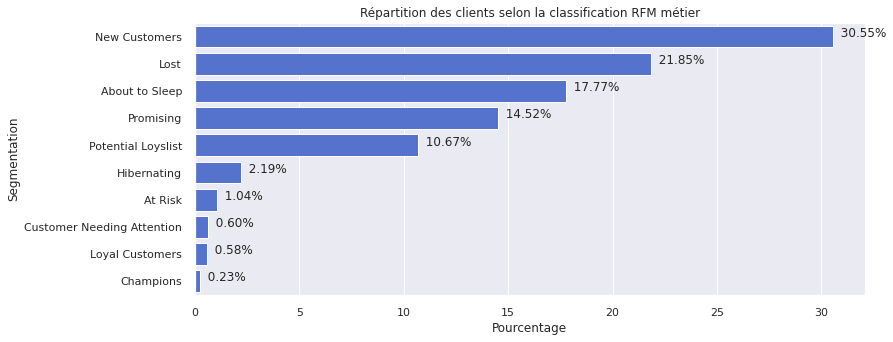

In [22]:
# Affichage des répartitions par %
sns.set()
plt.figure(figsize=(12, 5))

percent = (rfm['segment'].value_counts(normalize=True)*100).reset_index(name='Pourcentage')

ax = sns.barplot(x=percent['Pourcentage'], y=percent['index'], color='royalblue')

for i, v in enumerate(percent['Pourcentage']):
    ax.text(v, i, "  {:.2f}".format(v) + "%")

_ = ax.set_ylabel('Segmentation')
_ = ax.set_xlabel('Pourcentage')
_ = ax.set_title('Répartition des clients selon la classification RFM métier')

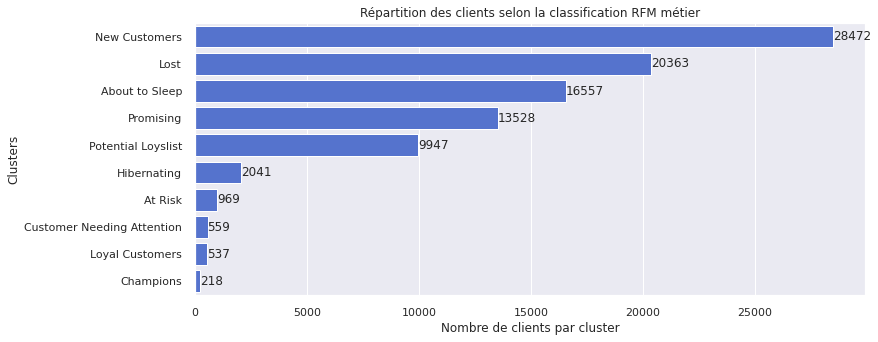

In [23]:
# Affichage des répartitions par nombre
sns.set()
plt.figure(figsize=(12, 5))

count = rfm['segment'].value_counts().reset_index(name='Counts')

ax = sns.barplot(x=count['Counts'], y=count['index'], color='royalblue')

for container in ax.containers:
    ax.bar_label(container)

_ = ax.set_ylabel('Clusters')
_ = ax.set_xlabel('Nombre de clients par cluster')
_ = ax.set_title('Répartition des clients selon la classification RFM métier')

**New Customers**  
- Client ayant acheté récemment mais pas souvent  
**Lost**
- Score les plus faibles sur les 3 variables  
**Promising**
- Client récent mais ayant dépensé peu  
**Potential Loyalist :**
- Client récent, bonne somme d'argent dépensée, a acheté plus d'une fois  
**Hibernating :**
- Client ancien, faible montant et qu'un seul achat  
**About to sleep :**  
- Client n'ayant pas acheté depuis longtemps avec une chance de recommencer  
**At risk :**  
- Client ayant acheté plusieurs fois des petits montants mais pas récemment  
**Customer Needing Attention :**  
- Client ayant réalisé un achat récemment et ne sachant pas où faire le suivant  
**Loyal Customers :**
- Client ayant dépensé souvent et une somme relativement importante  
**Champions :**  
- Client qui achète régulièrement et des gros montants  

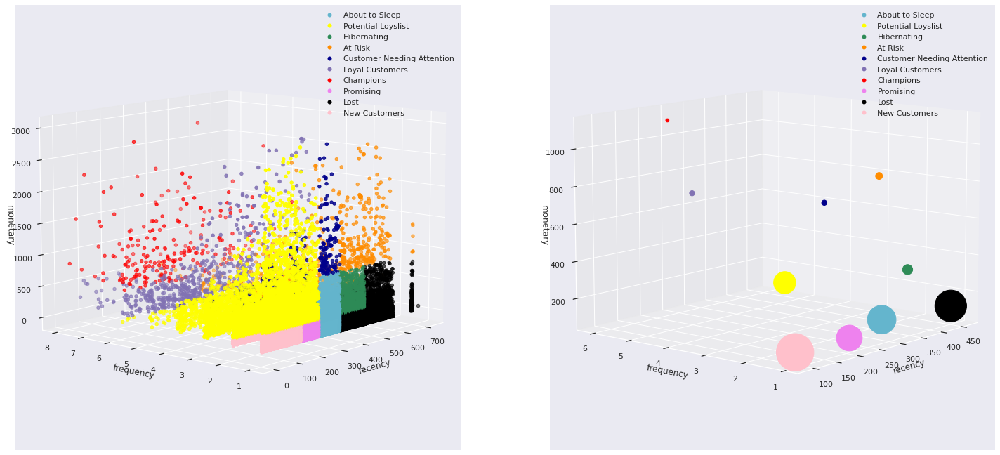

In [24]:
# plot 3D des observations + des centroïds
colors = {'About to Sleep': 'c', 'Potential Loyslist': 'yellow', 'Hibernating': 'seagreen', 'At Risk': 'darkorange',
          'Customer Needing Attention': 'darkblue', 'Loyal Customers': 'm', 'Champions': 'red', 'Promising': 'violet',
          'Lost': 'black', 'New Customers': 'pink'}

colors_2 = ['c', 'darkorange', 'red', 'darkblue', 'seagreen', 'black', 'm', 'pink', 'yellow', 'violet']

markers = [plt.Line2D([0, 0], [0, 0],
                      color=color,
                      marker='o',
                      linestyle='') for color in colors.values()]

fig, axes = plt.subplots(1, 2, figsize=(25, 12), subplot_kw=dict(projection='3d'))

axes[0].scatter3D(rfm['recency'],
                  rfm['frequency'],
                  rfm['monetary'],
                  #  alpha=0.5,
                  marker='o',
                  c=rfm['segment'].apply(lambda x: colors[x]),
                  )

axes[1].scatter3D(cluster_center_rec, cluster_center_freq, cluster_center_mon,
                  c=colors_2,
                  s=cluster_count/30,
                  marker='o',
                  alpha=1
                  )

for i in range(2):
    axes[i].set_xlabel('recency')
    axes[i].set_ylabel('frequency')
    axes[i].set_zlabel('monetary')
    axes[i].legend(markers, colors.keys())
    axes[i].view_init(10, -140)   # Le premier regle l'azimut et le second la rotation autour de z

plt.show()

In [25]:
# Plot 3D orientable
plt.figure(figsize=(12, 8))
fig = px.scatter_3d(rfm, x='recency',
                    y='frequency',
                    z='monetary',
                    color=rfm['segment'],
                    width=800,
                    height=500)

fig.update_traces(marker_size=1.5)

<Figure size 864x576 with 0 Axes>

Conclusion :  
Ce clustering est intéressant, seuls les champions sont dans une catégorie inférieure à 500 individus.

# Test K-means clustering sur RFM

L'objectif ici sera de réaliser un K'means sur l'ensemble des données RFM et non plus 1 KMeans par colonne

In [26]:
# On repart du df RFM en ne prenant pas les clusters définis précédemment + scale les données (les outliers sont déjà supprimés)
data_rfm = rfm[['recency','frequency','monetary']]
scaler = StandardScaler()
data_rfm_scaled = pd.DataFrame(scaler.fit_transform(data_rfm), columns=data_rfm.columns)
data_rfm_scaled.shape

(93191, 3)

In [27]:
# Nombre optimal de cluster
inertie = []
range_clusters = [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]

for num_clusters in range_clusters:
    kmeans = KMeans(n_clusters=num_clusters, init='k-means++')
    kmeans.fit(data_rfm_scaled)

    inertie.append([num_clusters, kmeans.inertia_])

inertie = pd.DataFrame(inertie, columns=['Nombre de cluster', 'Inertie'])

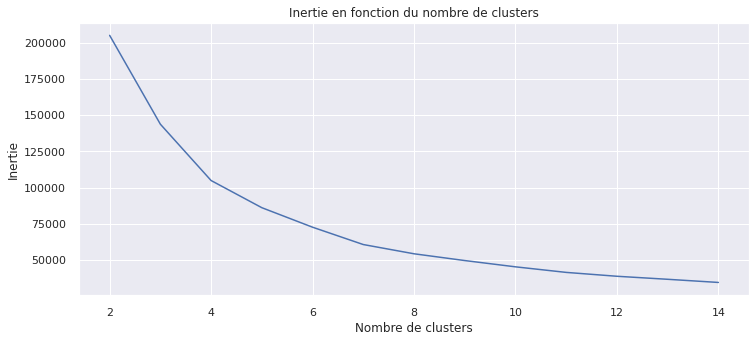

In [28]:
# Plot de l'inertie
sns.set()
plt.figure(figsize=(12, 5))

ax = plt.plot(inertie['Nombre de cluster'], inertie['Inertie'])
    
_ = plt.ylabel('Inertie')
_ = plt.xlabel('Nombre de clusters')
_ = plt.title('Inertie en fonction du nombre de clusters')

In [29]:
# Score de silhouette
range_clusters = [2, 3, 4, 5, 6, 7, 8]

for num_clusters in range_clusters:
    kmeans = KMeans(n_clusters=num_clusters, init='k-means++')
    kmeans.fit(data_rfm)
    
    cluster_labels = kmeans.labels_
    
    # silhouette score
    silhouette_score = metrics.silhouette_score(data_rfm, cluster_labels)
    print(f"For n_clusters={num_clusters}, Le score silhouette est {silhouette_score}")

For n_clusters=2, Le score silhouette est 0.704636988420337
For n_clusters=3, Le score silhouette est 0.4369198883263294
For n_clusters=4, Le score silhouette est 0.459956443346123
For n_clusters=5, Le score silhouette est 0.38307098210798535
For n_clusters=6, Le score silhouette est 0.4005349501239063
For n_clusters=7, Le score silhouette est 0.40678789079705346
For n_clusters=8, Le score silhouette est 0.40467171270322816


Choix d'utiliser 4 clusters

CPU times: user 2 µs, sys: 1e+03 ns, total: 3 µs
Wall time: 6.91 µs


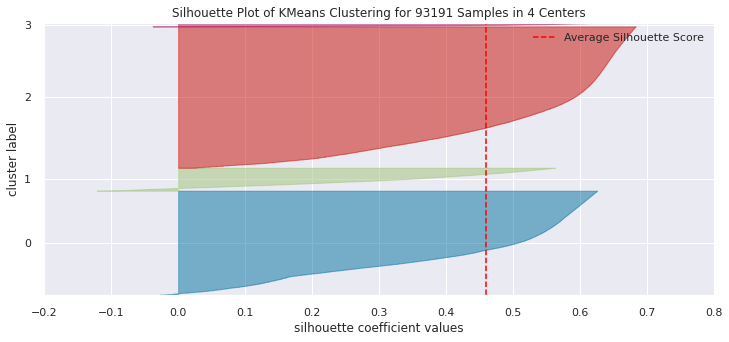

<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 93191 Samples in 4 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [30]:
%time
plt.figure(figsize=(12, 5))

# Création du modèle et du visualiser
model = KMeans(4, init='k-means++')
visualizer = SilhouetteVisualizer(model, colors='yellowbrick')

visualizer.fit(data_rfm)        # Fit des données pour le visualiser
visualizer.show() 

In [31]:
# Prédictions avec 4 clusters
kmeans = KMeans(n_clusters=4, init='k-means++', random_state=0)
kmeans.fit(data_rfm_scaled)

# Création d'un dataframe en inversant StandardScaler pour une visualisation plus facilement interprétable
data_rfm_scaled_inversed = pd.DataFrame(scaler.inverse_transform(data_rfm_scaled), columns=data_rfm_scaled.columns)

data_rfm_scaled_inversed['Cluster'] = kmeans.labels_
data_rfm_scaled['Cluster'] = kmeans.labels_

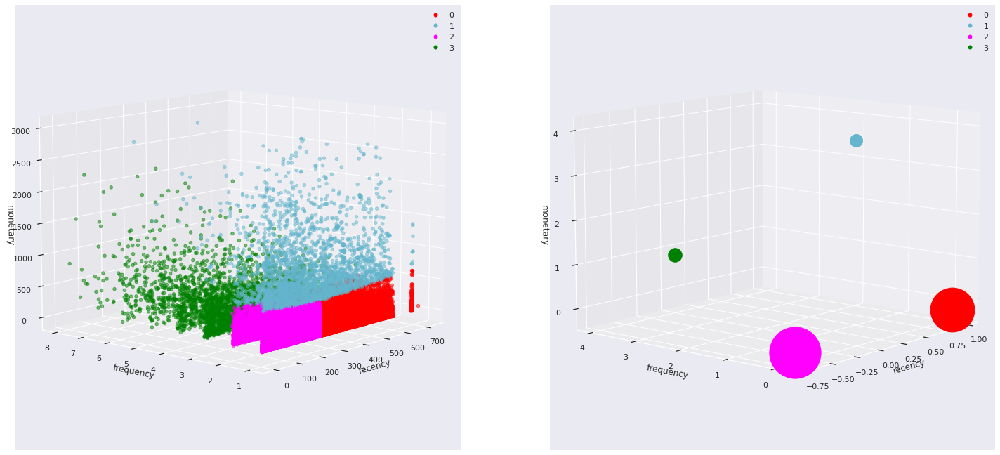

In [32]:
# Plot 3D des observations et des centroïds
colors = {0: 'red', 1: 'c', 2: 'magenta', 3: 'green'}

markers = [plt.Line2D([0, 0], [0, 0],
                      color=color,
                      marker='o',
                      linestyle='') for color in colors.values()]

fig, axes = plt.subplots(1, 2, figsize=(25, 12), subplot_kw=dict(projection='3d'))

axes[0].scatter3D(data_rfm_scaled_inversed['recency'],
                  data_rfm_scaled_inversed['frequency'],
                  data_rfm_scaled_inversed['monetary'],
                  alpha=0.5,
                  marker='o',
                  c=data_rfm_scaled_inversed['Cluster'].apply(lambda x: colors[x]),
                  )

axes[1].scatter3D(kmeans.cluster_centers_[0, 0], kmeans.cluster_centers_[0, 1], kmeans.cluster_centers_[0, 2],
                  color='red', s=10000*data_rfm_scaled_inversed.Cluster.value_counts(normalize=True)[0])
axes[1].scatter3D(kmeans.cluster_centers_[1, 0], kmeans.cluster_centers_[1, 1], kmeans.cluster_centers_[1, 2],
                  color='c', s=10000*data_rfm_scaled_inversed.Cluster.value_counts(normalize=True)[1])
axes[1].scatter3D(kmeans.cluster_centers_[2, 0], kmeans.cluster_centers_[2, 1], kmeans.cluster_centers_[2, 2],
                  color='magenta', s=10000*data_rfm_scaled_inversed.Cluster.value_counts(normalize=True)[2])
axes[1].scatter3D(kmeans.cluster_centers_[3, 0], kmeans.cluster_centers_[3, 1], kmeans.cluster_centers_[3, 2],
                  color='green', s=10000*data_rfm_scaled_inversed.Cluster.value_counts(normalize=True)[3])


for i in range(2):
    axes[i].set_xlabel('recency')
    axes[i].set_ylabel('frequency')
    axes[i].set_zlabel('monetary')
    axes[i].legend(markers, colors.keys(), numpoints=1)
    # ax.view_init(30,60)
    axes[i].view_init(10, -140)   # Le premier regle l'azimut et le second la rotation autour de z

plt.show()

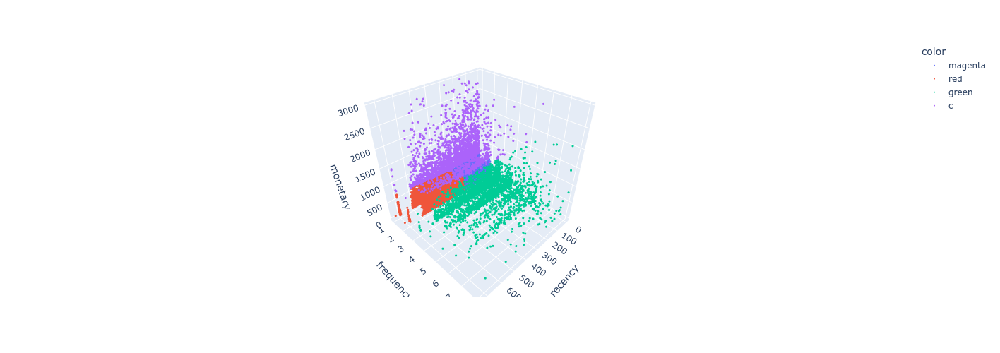

<Figure size 864x360 with 0 Axes>

In [33]:
# Plot 3D orientable
plt.figure(figsize=(12, 5))
fig = px.scatter_3d(data_rfm_scaled_inversed, x='recency',
                    y='frequency',
                    z='monetary',
                    color=data_rfm_scaled_inversed['Cluster'].apply(lambda x: colors[x]),
                    width=800,
                    height=500)

fig.update_traces(marker_size=1)

<AxesSubplot:xlabel='Cluster', ylabel='recency'>

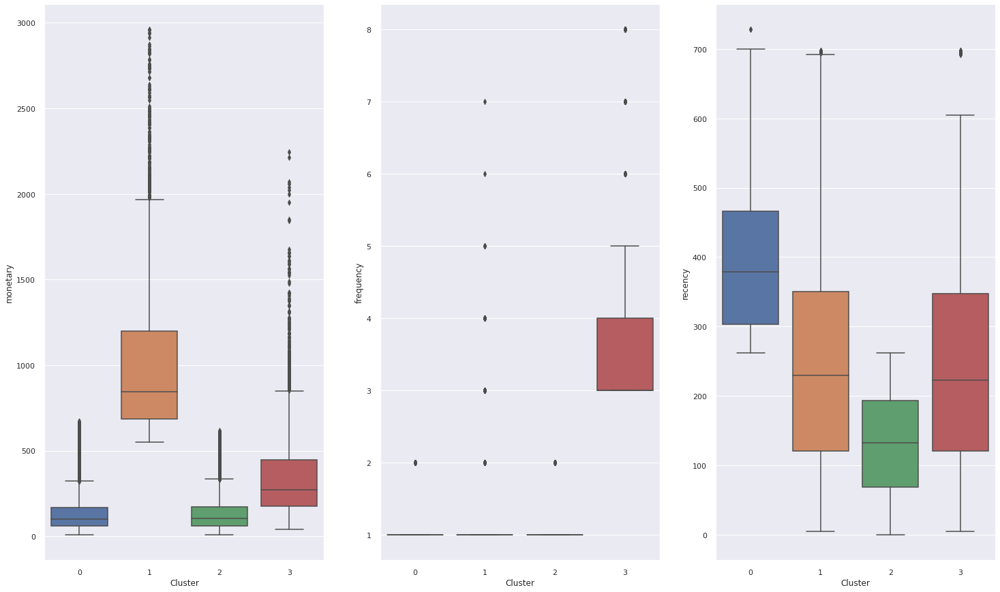

In [34]:
# Visualisation des distributions
sns.set()
fig, axes = plt.subplots(1, 3)
plt.rcParams["figure.figsize"] = (25, 5)

sns.boxplot(x='Cluster', y='monetary', data=data_rfm_scaled_inversed, ax=axes[0])
sns.boxplot(x='Cluster', y='frequency', data=data_rfm_scaled_inversed, ax=axes[1])
sns.boxplot(x='Cluster', y='recency', data=data_rfm_scaled_inversed, ax=axes[2])

On pourrait résumer les clusters par :  
    - cluster 0 : Client n'ayant acheté q'une seule fois pour un petit montant et pas récemment        -> client potentiellement perdu  
    - cluster 1 : Client ayant acheté une fois, pour un montant élevé et relativement récemment        -> client à potentiel    
    - cluster 2 : Client n'ayant acheté q'une seule fois pour un petit montant et récemment            -> nouveau client  
    - cluster 3 : Client ayant acheté plus d'un fois, pour un montant moyen et relativement récemment  -> client loyal 
    
    

In [35]:
# Fonction permettant d'appliquer les segments
def segment(x):
    if x == 0:
        return 'Client potentiellement perdu'
    if x == 1:
        return 'Client à potentiel'
    if x == 2:
        return 'Nouveau client'
    else:
        return 'Client loyal'

In [36]:
# Application des segments
data_rfm_scaled_inversed['segment'] = data_rfm_scaled_inversed['Cluster'].apply(segment)

In [37]:
# Création d'un dataframe pour la visualisation
data_rfm_scaled_segmented = pd.DataFrame(data_rfm_scaled_inversed.groupby('segment').size(),columns=['totaux'])

<Figure size 1800x360 with 0 Axes>

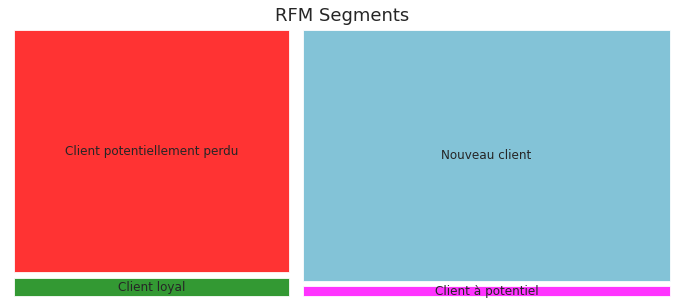

In [38]:
# Plot en vue éclatée
fig = plt.gcf()
plt.figure(figsize=(12, 5))

squarify.plot(sizes=data_rfm_scaled_segmented['totaux'],
              label=data_rfm_scaled_segmented.index,
              color=['green', 'red', 'magenta', 'c'],
              alpha=0.8, pad=True)
plt.title("RFM Segments", fontsize=18)
plt.axis('off')
plt.show()

In [39]:
# CRéation d'un df pour les centroïds
cluster = data_rfm_scaled.groupby('Cluster').mean()
cluster

,recency,frequency,monetary
Cluster,,,
0,0.980302,-0.165747,-0.178561
1,0.016443,0.077396,4.001575
2,-0.721166,-0.167297,-0.172873
3,0.009196,4.023298,0.869209


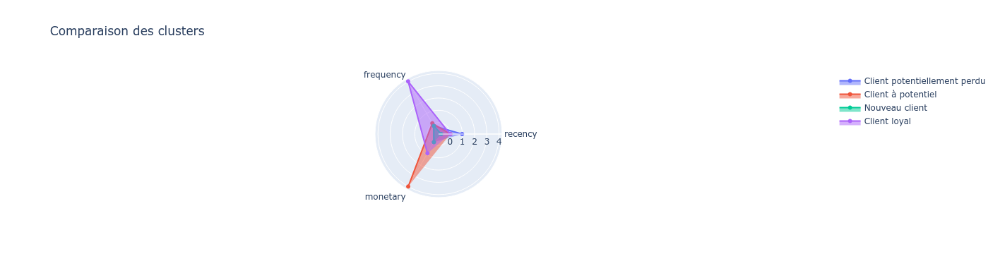

<Figure size 1080x1080 with 0 Axes>

In [40]:
# Visualisation en radar
pyo.renderers.render_default = 'jupyterlab'

plt.figure(figsize=(15, 15))

categories = ['recency', 'frequency', 'monetary', 'review_score_mean', 'Nb_payment_moyen']
categories = [*categories, categories[0]]

Cluster_0 = cluster.iloc[0].to_list()
Cluster_1 = cluster.iloc[1].to_list()
Cluster_2 = cluster.iloc[2].to_list()
Cluster_3 = cluster.iloc[3].to_list()
# Cluster_4 = cluster.iloc[4].to_list()

fig = go.Figure(
    data=[
        go.Scatterpolar(r=Cluster_0, theta=categories, fill='toself', name='Client potentiellement perdu'),
        go.Scatterpolar(r=Cluster_1, theta=categories, fill='toself', name='Client à potentiel'),
        go.Scatterpolar(r=Cluster_2, theta=categories, fill='toself', name='Nouveau client'),
        go.Scatterpolar(r=Cluster_3, theta=categories, fill='toself', name='Client loyal'),
        # go.Scatterpolar(r=Cluster_4, theta=categories, fill='toself', name='Cluster_4')
    ],
    layout=go.Layout(
        title=go.layout.Title(text='Comparaison des clusters'),
        polar={'radialaxis': {'visible': True}},
        showlegend=True
    )
)

fig.show()

In [41]:
# Nécessité de scaler les données pour le graphique en radar
def rescale(x):
    '''
    Fonction permettant de scale une série panda. La valeur la plus forte de la serie aura pour valeur 1 et la moins forte 0
    '''
    return (x - np.min(x)) / np.ptp(x)

<AxesSubplot:>

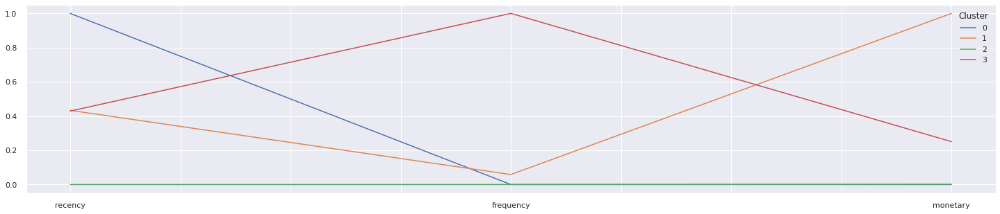

In [42]:
cluster_scaled = cluster.apply(lambda x: rescale(x))
cluster_scaled.T.plot()

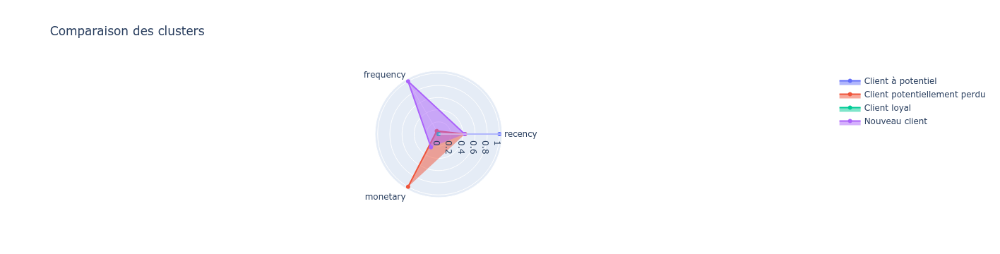

<Figure size 1080x1080 with 0 Axes>

In [43]:
# Visualisation en radar
pyo.renderers.render_default = 'jupyterlab'

plt.figure(figsize=(15, 15))

categories = ['recency', 'frequency', 'monetary', 'review_score_mean', 'Nb_payment_moyen']
categories = [*categories, categories[0]]

Cluster_0 = cluster_scaled.iloc[0].to_list()
Cluster_1 = cluster_scaled.iloc[1].to_list()
Cluster_2 = cluster_scaled.iloc[2].to_list()
Cluster_3 = cluster_scaled.iloc[3].to_list()
# Cluster_4 = cluster.iloc[4].to_list()

fig = go.Figure(
    data=[
        go.Scatterpolar(r=Cluster_0, theta=categories, fill='toself', name='Client à potentiel'),
        go.Scatterpolar(r=Cluster_1, theta=categories, fill='toself', name='Client potentiellement perdu'),
        go.Scatterpolar(r=Cluster_2, theta=categories, fill='toself', name='Client loyal'),
        go.Scatterpolar(r=Cluster_3, theta=categories, fill='toself', name='Nouveau client'),
        # go.Scatterpolar(r=Cluster_4, theta=categories, fill='toself', name='Cluster_4')
    ],
    layout=go.Layout(
        title=go.layout.Title(text='Comparaison des clusters'),
        polar={'radialaxis': {'visible': True}},
        showlegend=True
    )
)

fig.show()

In [44]:
# Score silhouette
score = metrics.silhouette_score(data_rfm_scaled, data_rfm_scaled['Cluster'])
print(f"Le score silhoutte est {round(score, 3)}")

Le score silhoutte est 0.609


/home/agent/Logiciels/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_mds.py:506: UserWarning:

The MDS API has changed. ``fit`` now constructs an dissimilarity matrix from data. To use a custom dissimilarity matrix, set ``dissimilarity='precomputed'``.



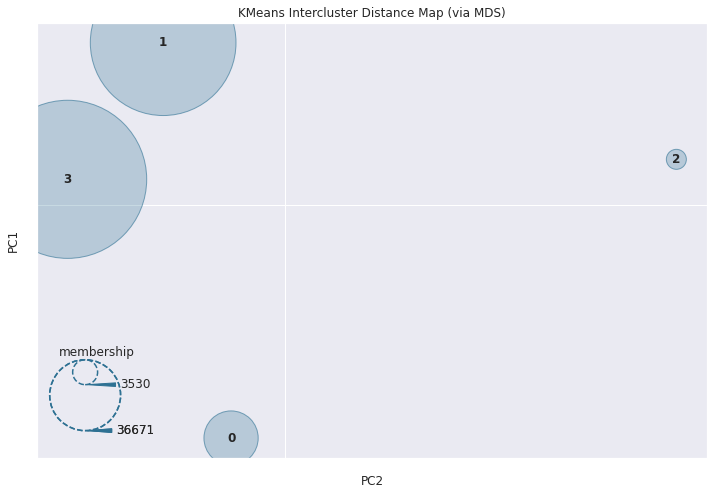

InterclusterDistance(ax=<AxesSubplot:title={'center':'KMeans Intercluster Distance Map (via MDS)'}, xlabel='PC2', ylabel='PC1'>,
                     estimator=KMeans(n_clusters=4, random_state=0))

In [45]:
# Visualisation des clusters en 2D via Yellowbrick
plt.figure(figsize=(12, 8))
intercluster_distance(KMeans(n_clusters=4, init='k-means++', random_state=0), data_rfm_scaled)

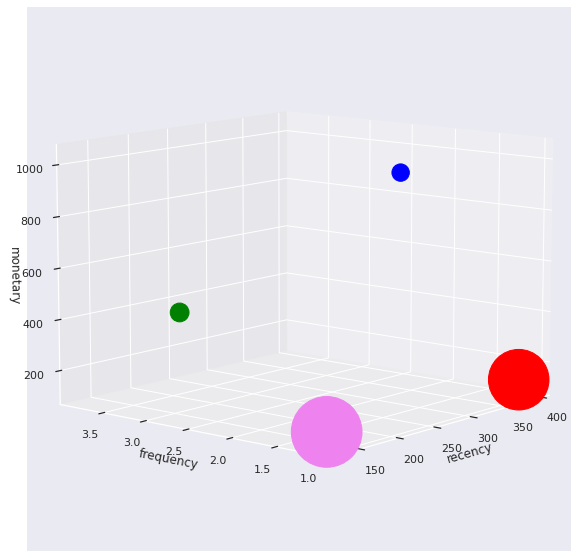

In [46]:
# Graphique avec centroïds pour la présentation
cluster = data_rfm_scaled_inversed.groupby('Cluster').mean()
cluster_count = data_rfm_scaled_inversed.groupby('Cluster').count()
cluster_count['somme'] = cluster_count['recency'] + cluster_count['frequency'] + cluster_count['monetary']

colors_3 = ['red', 'blue', 'violet', 'green']
sns.set()
plt.figure(figsize=(10, 10))
ax = plt.axes(projection='3d')
ax.scatter3D(cluster['recency'].values, cluster['frequency'].values, cluster['monetary'].values,
             c=colors_3,
             s=cluster_count['somme']/30,
             marker='o',
             alpha=1
             )
ax.set_xlabel('recency')
ax.set_ylabel('frequency')
ax.set_zlabel('monetary')

ax.view_init(10, -140)

## Ajout de variables pour l'étude  

### Test 1 :

- Ajout de la note moyenne par client

In [47]:
rfm_2 = pd.merge(recency, frequency, on='customer_unique_id')
rfm_2 = pd.merge(rfm_2, monetary, on='customer_unique_id')
rfm_2.shape

(93395, 4)

In [48]:
# Review_score_mean - correspond au score moyen par commande
Review_score_mean = data.groupby(['customer_unique_id', 'order_id']).agg({"review_score": 'mean'})
Review_score_mean.columns = ['review_score_mean']
Review_score_mean = Review_score_mean.groupby(['customer_unique_id'])['review_score_mean'].mean()
Review_score_mean = Review_score_mean.reset_index()

In [49]:
rfm_2 = rfm_2.merge(Review_score_mean, how='left', on='customer_unique_id')
rfm_2.shape

(93395, 5)

In [50]:
# Traitement des outliers
rfm_2.drop(['customer_unique_id'], axis=1, inplace=True)
rfm_2 = traitement_outlier_quantile(rfm_2, 0.01, 0.99)

,recency,frequency,monetary,review_score_mean
count,93191.000000,93191.000000,93191.000000,93191.000000
mean,241.702053,1.219345,168.848508,4.105607
std,153.126302,0.647839,211.395671,1.323753
min,0.000000,1.000000,10.070000,1.000000
1%,13.000000,1.000000,22.840000,1.000000
5%,27.000000,1.000000,32.790000,1.000000
10%,45.000000,1.000000,40.680000,1.000000
25%,118.000000,1.000000,64.000000,4.000000
50%,222.000000,1.000000,110.090000,5.000000
75%,351.000000,1.000000,188.385000,5.000000


In [51]:
# Scale des données
scaler = StandardScaler()
data_rfm_2_scaled = pd.DataFrame(scaler.fit_transform(rfm_2), columns=rfm_2.columns)
data_rfm_2_scaled.shape

(93191, 4)

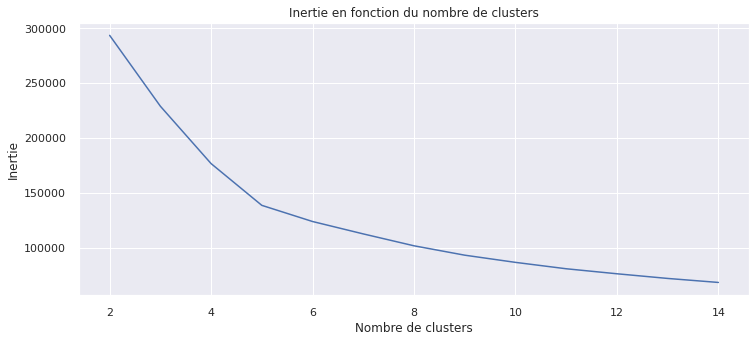

In [52]:
# Nombre optimal de cluster
inertie = []
range_clusters = [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]
# range_clusters = range(1, 50, 5)

for num_clusters in range_clusters:
    kmeans = KMeans(n_clusters=num_clusters, init='k-means++')
    kmeans.fit(data_rfm_2_scaled)

    inertie.append([num_clusters, kmeans.inertia_])

inertie = pd.DataFrame(inertie, columns=['Nombre de cluster', 'Inertie'])

sns.set()
plt.figure(figsize=(12, 5))

ax = plt.plot(inertie['Nombre de cluster'], inertie['Inertie'])

_ = plt.ylabel('Inertie')
_ = plt.xlabel('Nombre de clusters')
_ = plt.title('Inertie en fonction du nombre de clusters')

In [53]:
# Score de silhouette
range_clusters = [3, 4, 5, 6]

for num_clusters in range_clusters:
    kmeans = KMeans(n_clusters=num_clusters)
    kmeans.fit(data_rfm_2_scaled)
    
    cluster_labels = kmeans.labels_
    
    # silhouette score
    silhouette_score = metrics.silhouette_score(data_rfm_2_scaled, cluster_labels)
    print(f"For n_clusters={num_clusters}, Le score silhouette est {silhouette_score}")

For n_clusters=3, Le score silhouette est 0.37413681495132173
For n_clusters=4, Le score silhouette est 0.34942011094880276
For n_clusters=5, Le score silhouette est 0.3667416655626255
For n_clusters=6, Le score silhouette est 0.37769637675601014


Choix pour 5 clusters

In [54]:
# Prédictions avec 5 clusters
kmeans = KMeans(n_clusters=5, init='k-means++', random_state=0)
kmeans.fit(data_rfm_2_scaled)

# Création d'un dataframe en inversant StandardScaler pour une meilleure visualisation
data_rfm_2_scaled_inversed = pd.DataFrame(scaler.inverse_transform(data_rfm_2_scaled), columns=data_rfm_2_scaled.columns)

data_rfm_2_scaled['Cluster'] = kmeans.labels_
data_rfm_2_scaled_inversed['Cluster'] = kmeans.labels_

<AxesSubplot:xlabel='Cluster', ylabel='review_score_mean'>

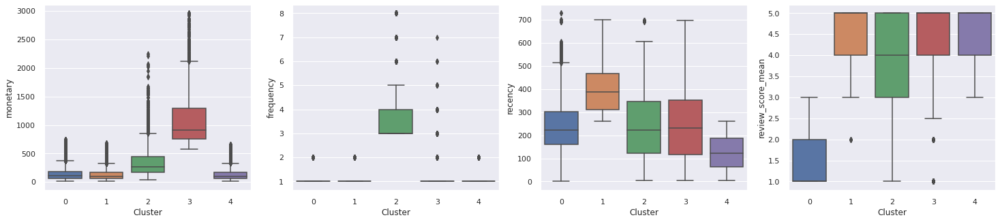

<Figure size 1800x360 with 0 Axes>

In [55]:
# Visualisation des distributions
sns.set()
fig, axes = plt.subplots(1, 4)
plt.figure(figsize=(25, 5))

sns.boxplot(x='Cluster', y='monetary', data=data_rfm_2_scaled_inversed, ax=axes[0])
sns.boxplot(x='Cluster', y='frequency', data=data_rfm_2_scaled_inversed, ax=axes[1])
sns.boxplot(x='Cluster', y='recency', data=data_rfm_2_scaled_inversed, ax=axes[2])
sns.boxplot(x='Cluster', y='review_score_mean', data=data_rfm_2_scaled_inversed, ax=axes[3])

On pourrait résumer les clusters par :  
    - cluster 0 : Client n'ayant acheté q'une seule fois pour un petit montant, relativement récemment mais mauvaise note       -> client potentiellement perdu  
    - cluster 1 : Client ayant acheté qu'une fois, pour un montant faible mais il ya a longtemps et avec une bonne note         -> client à risque    
    - cluster 2 : Client ayant acheté plusieurs fois, pour un montant moyen, relativement récemment et avec une bonne note      -> client loyal  
    - cluster 3 : Client ayant acheté qu'une fois, pour un montant gros montant, relativement récemment et avec une bonne note  -> bon client   
    - cluster 4 : Client ayant acheté qu'une fois, pour un montant petit montant, récemment et avec une bonne note              -> nouveau client     
    

In [56]:
# Fonction de définition des segments
def segment(x):
    if x == 0:
        return 'Client potentiellement perdu'
    if x == 1:
        return 'Client à risque'
    if x == 2:
        return 'Client loyal'
    if x == 3:
        return 'Bon client'
    else:
        return 'Nouveau client'

In [57]:
# Application des segments
data_rfm_2_scaled_inversed['segment'] = data_rfm_2_scaled_inversed['Cluster'].apply(segment)

In [58]:
# Création df avec centroïds
cluster = data_rfm_2_scaled.groupby('Cluster').mean()
cluster

,recency,frequency,monetary,review_score_mean
Cluster,,,,
0,0.003773,-0.077143,-0.099250,-1.856843
1,1.009072,-0.180871,-0.176692,0.399715
2,0.008850,4.018333,0.861160,-0.310617
3,0.017872,0.109580,4.367234,0.018313
4,-0.760256,-0.188388,-0.174681,0.431252


<AxesSubplot:>

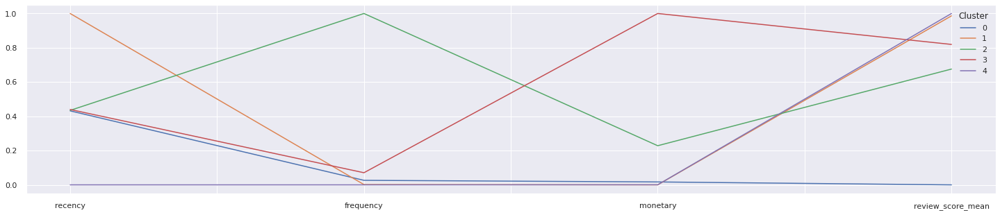

In [59]:
# Scale des centroïds pour une meilleure visulisation en radar
cluster_scaled = cluster.apply(lambda x: rescale(x))
cluster_scaled.T.plot()

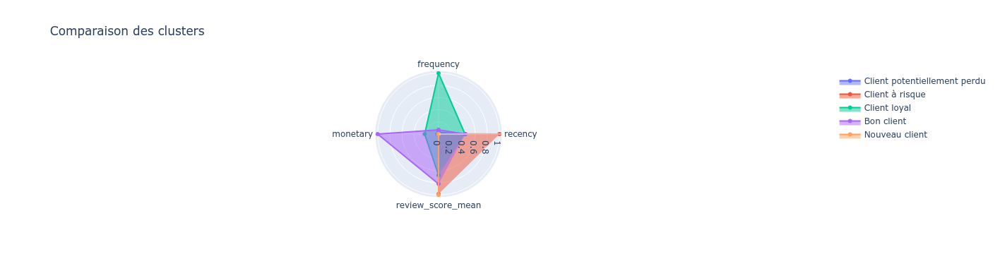

<Figure size 1080x1080 with 0 Axes>

In [60]:
# Graphique en radar
pyo.renderers.render_default = 'jupyterlab'

plt.figure(figsize=(15, 15))

categories = ['recency', 'frequency', 'monetary', 'review_score_mean']
categories = [*categories, categories[0]]

Cluster_0 = cluster_scaled.iloc[0].to_list()
Cluster_1 = cluster_scaled.iloc[1].to_list()
Cluster_2 = cluster_scaled.iloc[2].to_list()
Cluster_3 = cluster_scaled.iloc[3].to_list()
Cluster_4 = cluster_scaled.iloc[4].to_list()

fig = go.Figure(
    data=[
        go.Scatterpolar(r=Cluster_0, theta=categories, fill='toself', name='Client potentiellement perdu'),
        go.Scatterpolar(r=Cluster_1, theta=categories, fill='toself', name='Client à risque'),
        go.Scatterpolar(r=Cluster_2, theta=categories, fill='toself', name='Client loyal'),
        go.Scatterpolar(r=Cluster_3, theta=categories, fill='toself', name='Bon client'),
        go.Scatterpolar(r=Cluster_4, theta=categories, fill='toself', name='Nouveau client')
        ],
    layout=go.Layout(
        title=go.layout.Title(text='Comparaison des clusters'),
        polar={'radialaxis': {'visible': True}},
        showlegend=True
    )
)

fig.show()

<Figure size 1800x360 with 0 Axes>

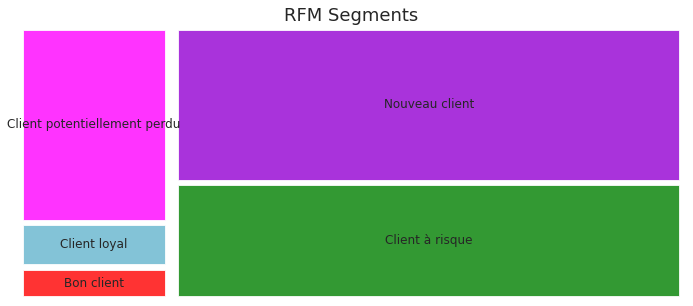

In [61]:
# Vue éclatée
data_rfm_2_scaled_segmented = pd.DataFrame(data_rfm_2_scaled_inversed.groupby('segment').size(), columns=['totaux'])

colors = {0: 'red', 1: 'c', 2: 'magenta', 3: 'green', 4: 'darkviolet'}
fig = plt.gcf()
plt.figure(figsize=(12, 5))

squarify.plot(sizes=data_rfm_2_scaled_segmented['totaux'],
              label=data_rfm_2_scaled_segmented.index,
              color=['red', 'c', 'magenta', 'green', 'darkviolet'],
              alpha=0.8, pad=True)
plt.title("RFM Segments", fontsize=18)
plt.axis('off')
plt.show()

In [62]:
# Score silhouette
score = metrics.silhouette_score(data_rfm_2_scaled, data_rfm_2_scaled['Cluster'])
print(f"Le score silhoutte est {round(score, 3)}")

Le score silhoutte est 0.579


/home/agent/Logiciels/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_mds.py:506: UserWarning:

The MDS API has changed. ``fit`` now constructs an dissimilarity matrix from data. To use a custom dissimilarity matrix, set ``dissimilarity='precomputed'``.



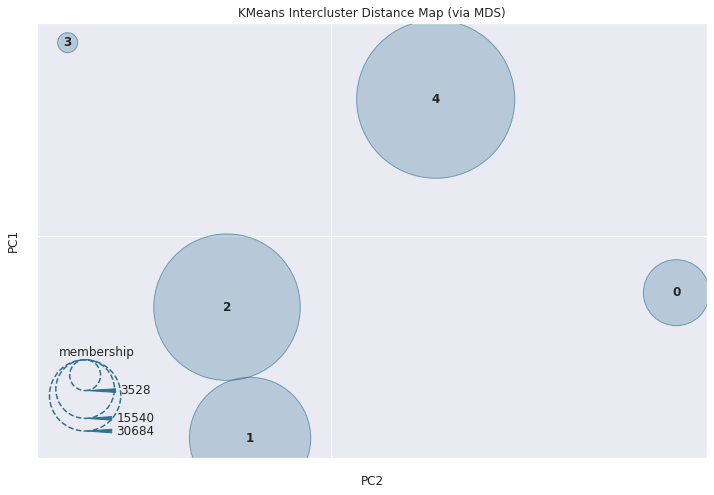

InterclusterDistance(ax=<AxesSubplot:title={'center':'KMeans Intercluster Distance Map (via MDS)'}, xlabel='PC2', ylabel='PC1'>,
                     estimator=KMeans(n_clusters=5, random_state=0))

In [63]:
# Visualisation des clusters en 2D via Yellowbrick
plt.figure(figsize=(12, 8))
intercluster_distance(KMeans(n_clusters=5, init='k-means++', random_state=0), data_rfm_2_scaled)

On observe que les clusters sont bien séparés. Le score silhoutte est meilleur en prenant en compte la note moyenne.

### Test 2 :

- Ajout de la note moyenne par client
- Ajout du nombre moyen d'articles par client - non conservé
- Ajout du nombre moyen de type de paiement par client
- Ajout du nombre moyen de paiement par client  - non conservé

Après tests, il apparait que les clusters ne différencient pas les types de paiements ainsi que le nombre moyen d'articles. En revanche, ils distinguent bien le type de paiements.

In [64]:
rfm_3 = pd.merge(recency, frequency, on='customer_unique_id')
rfm_3 = pd.merge(rfm_3, monetary, on='customer_unique_id')
rfm_3.shape

(93395, 4)

In [65]:
# Review_score_mean - correspond au score moyen par commande
Review_score_mean = data.groupby(['customer_unique_id','order_id']).agg({"review_score": 'mean'})
Review_score_mean.columns = ['review_score_mean']
Review_score_mean = Review_score_mean.groupby(['customer_unique_id'])['review_score_mean'].mean()
Review_score_mean = Review_score_mean.reset_index()

In [66]:
### Nb_payment_type - correspond au nombre de type de paiements différents utilisés par un client
Nb_payment_type = data.groupby(['customer_unique_id']).agg({'payment_type': lambda x: x.nunique()})
Nb_payment_type.columns = ['Nb_payment_type']
Nb_payment_type = Nb_payment_type.reset_index()

In [67]:
### Nb_articles - correspond au nombre d'articles moyen par commande    ***** non utilisé
# Nb_articles = data.groupby(['customer_unique_id','order_id']).agg({'product_id': lambda x: x.nunique()})
# Nb_articles.columns = ['Nombre_article']
# Nb_articles = Nb_articles.groupby(['customer_unique_id'])['Nombre_article'].mean()
# Nb_articles = Nb_articles.reset_index()

In [68]:
### Nb_payment_moy - correspond au nombre moyen de type de payment_installations différents utilisés par un client    ***** non utilisé
# Nb_payment_moy = data.groupby(['customer_unique_id','order_id']).agg({'payment_installments': 'max'})
# Nb_payment_moy.columns = ['Nb_payment_moyen']
# Nb_payment_moy = Nb_payment_moy.groupby(['customer_unique_id'])['Nb_payment_moyen'].mean()
# Nb_payment_moy = Nb_payment_moy.reset_index()

In [69]:
# Regroupement dans un df unique
rfm_3 = rfm_3.merge(Review_score_mean, how='left', on='customer_unique_id')
rfm_3 = rfm_3.merge(Nb_payment_type, how='left', on='customer_unique_id')
# rfm_3 = rfm_3.merge(Nb_articles, how='left', on='customer_unique_id')
# rfm_3 = rfm_3.merge(Nb_payment_moy, how='left', on='customer_unique_id')
rfm_3.shape

(93395, 6)

In [70]:
# Suppresion de l'identifiant unique et des outliers
rfm_3.drop(['customer_unique_id'], axis=1, inplace=True)
rfm_3 = traitement_outlier_quantile(rfm_3, 0.01, 0.99)

,recency,frequency,monetary,review_score_mean,Nb_payment_type
count,93191.000000,93191.000000,93191.000000,93191.000000,93191.000000
mean,241.702053,1.219345,168.848508,4.105607,1.025582
std,153.126302,0.647839,211.395671,1.323753,0.158631
min,0.000000,1.000000,10.070000,1.000000,1.000000
1%,13.000000,1.000000,22.840000,1.000000,1.000000
5%,27.000000,1.000000,32.790000,1.000000,1.000000
10%,45.000000,1.000000,40.680000,1.000000,1.000000
25%,118.000000,1.000000,64.000000,4.000000,1.000000
50%,222.000000,1.000000,110.090000,5.000000,1.000000
75%,351.000000,1.000000,188.385000,5.000000,1.000000


In [71]:
# Scale des données
scaler = StandardScaler()
data_rfm_3_scaled = pd.DataFrame(scaler.fit_transform(rfm_3), columns=rfm_3.columns)
data_rfm_3_scaled.shape

(93191, 5)

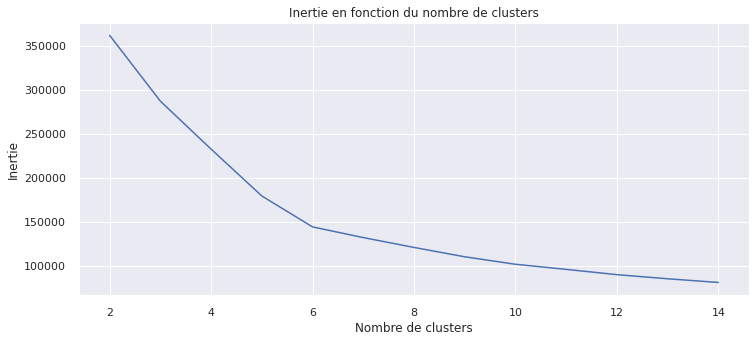

In [72]:
# Nombre optimal de cluster
inertie = []
range_clusters = [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]

for num_clusters in range_clusters:
    kmeans = KMeans(n_clusters=num_clusters, init='k-means++')
    kmeans.fit(data_rfm_3_scaled)

    inertie.append([num_clusters, kmeans.inertia_])

inertie = pd.DataFrame(inertie, columns=['Nombre de cluster', 'Inertie'])

sns.set()
plt.figure(figsize=(12, 5))

ax = plt.plot(inertie['Nombre de cluster'], inertie['Inertie'])

_ = plt.ylabel('Inertie')
_ = plt.xlabel('Nombre de clusters')
_ = plt.title('Inertie en fonction du nombre de clusters')

Choix sur 6 clusters

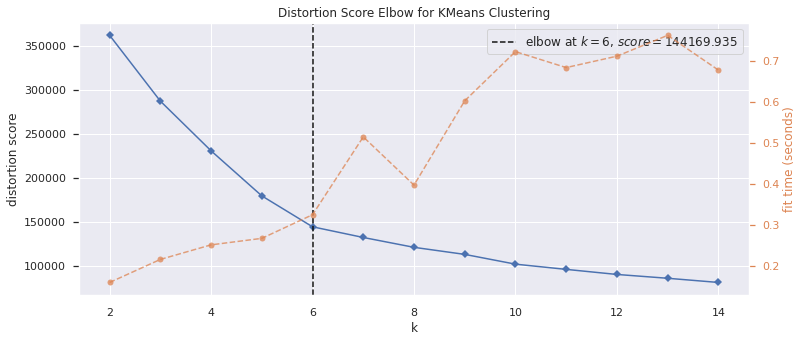

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [73]:
# Nombre optimal de cluster avec Yellowbrick
plt.figure(figsize=(12, 5))

model = KMeans()
visualizer = KElbowVisualizer(model, k=(2, 15))


visualizer.fit(data_rfm_3_scaled)        # Fit the data to the visualizer
visualizer.show() 

In [74]:
# Prédictions avec 6 clusters
kmeans = KMeans(n_clusters=6, init='k-means++', random_state = 0)
kmeans.fit(data_rfm_3_scaled)

# Création d'un dataframe en inversant StandardScaler pour une meilleure visualisation
data_rfm_3_scaled_inversed = pd.DataFrame(scaler.inverse_transform(data_rfm_3_scaled), columns=data_rfm_3_scaled.columns)

# Affectation des labels
data_rfm_3_scaled['Cluster'] = kmeans.labels_
data_rfm_3_scaled_inversed['Cluster'] = kmeans.labels_

<AxesSubplot:xlabel='Cluster', ylabel='Nb_payment_type'>

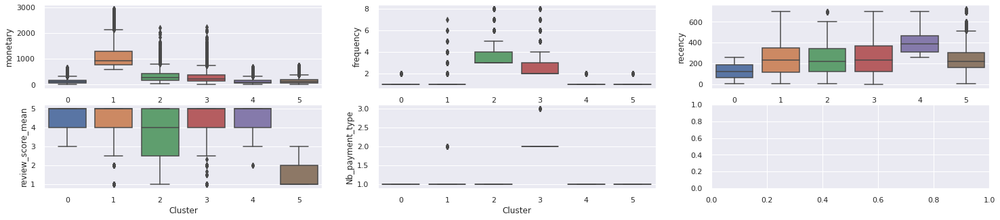

In [75]:
# Visualisation des distributions
sns.set()
fig, axes = plt.subplots(2, 3)
plt.rcParams["figure.figsize"] = (25, 8)

sns.boxplot(x='Cluster', y='monetary', data=data_rfm_3_scaled_inversed, ax=axes[0, 0])
sns.boxplot(x='Cluster', y='frequency', data=data_rfm_3_scaled_inversed, ax=axes[0, 1])
sns.boxplot(x='Cluster', y='recency', data=data_rfm_3_scaled_inversed, ax=axes[0, 2])
sns.boxplot(x='Cluster', y='review_score_mean', data=data_rfm_3_scaled_inversed, ax=axes[1, 0])
sns.boxplot(x='Cluster', y='Nb_payment_type', data=data_rfm_3_scaled_inversed, ax=axes[1, 1])

On pourrait résumer les clusters par :  
    - cluster 0 : Client ayant acheté qu'une fois, pour un petit montant, relativement récemment et avec une bonne note                 -> nouveau client  
    - cluster 1 : Client ayant acheté qu'une fois, pour un gros montant relativement récemment et avec une bonne note                   -> client prometteur   
    - cluster 2 : Client ayant acheté plusieurs fois, pour un montant moyen, relativement récemment et avec une note moyenne            -> client loyal  
    - cluster 3 : Client ayant acheté plusieurs fois, pour un montant moyen, relativement récemment et avec une bonne note              -> bon client  
    - cluster 4 : Client ayant acheté qu'une fois, pour un petit montant, pas récemment et avec une bonne note                          -> client à risque  
    - cluster 5 : Client ayant acheté qu'une fois, pour un petit montant, peu récemment et avec une mauvaise note                       -> client perdu
    

In [76]:
# Fonction d'application dse segments
def segment(x):
    if x == 0:
        return 'Nouveau client'
    if x == 1:
        return 'Client prometteur'
    if x == 2:
        return 'Client loyal'
    if x == 3:
        return 'Bon client'
    if x == 4:
        return 'Client à risque'
    else:
        return 'Client perdu'

In [77]:
# Application des segments
data_rfm_3_scaled_inversed['segment'] = data_rfm_3_scaled_inversed['Cluster'].apply(segment)

In [78]:
# Création d'un df avc les centroïds
cluster = data_rfm_3_scaled.groupby('Cluster').mean()
cluster

,recency,frequency,monetary,review_score_mean,Nb_payment_type
Cluster,,,,,
0,-0.760615,-0.212820,-0.180728,0.431842,-0.161267
1,0.010068,0.025988,4.401568,0.017234,-0.119030
2,0.009156,3.953605,0.805885,-0.357216,-0.161267
3,0.058662,2.028887,0.657814,0.007420,6.172126
4,1.008759,-0.209358,-0.183567,0.399885,-0.161267
5,0.003072,-0.101478,-0.107020,-1.858925,-0.161267


In [79]:
# Nécessité de scaler entre 0 et 1 pour le graphique en radar 
def rescale(x):
    '''
    Fonction permettant de scale une série panda. La valeur la plus forte de la serie aura pour valeur 1 et la moins forte 0
    '''
    return (x - np.min(x)) / np.ptp(x)

In [80]:
cluster_scaled = cluster.apply(lambda x: rescale(x))

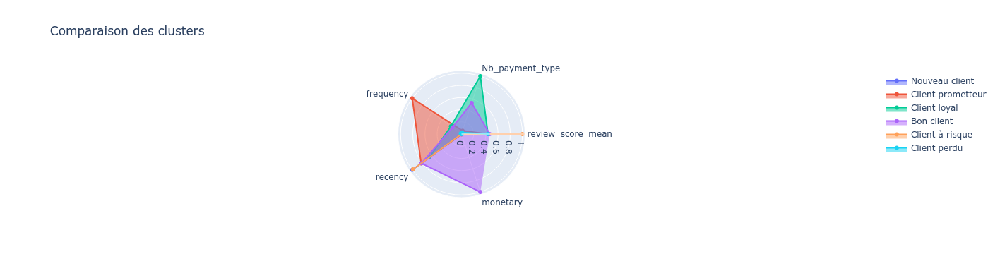

In [81]:
# Graphique en radar
categories = ['review_score_mean', 'Nb_payment_type', 'frequency', 'recency', 'monetary']
categories = [*categories, categories[0]]

Cluster_0 = cluster_scaled.iloc[0].to_list()
Cluster_1 = cluster_scaled.iloc[1].to_list()
Cluster_2 = cluster_scaled.iloc[2].to_list()
Cluster_3 = cluster_scaled.iloc[3].to_list()
Cluster_4 = cluster_scaled.iloc[4].to_list()
Cluster_5 = cluster_scaled.iloc[5].to_list()

fig = go.Figure(
    data=[
        go.Scatterpolar(r=Cluster_0, theta=categories, fill='toself', name='Nouveau client'),
        go.Scatterpolar(r=Cluster_1, theta=categories, fill='toself', name='Client prometteur'),
        go.Scatterpolar(r=Cluster_2, theta=categories, fill='toself', name='Client loyal'),
        go.Scatterpolar(r=Cluster_3, theta=categories, fill='toself', name='Bon client'),
        go.Scatterpolar(r=Cluster_4, theta=categories, fill='toself', name='Client à risque'),
        go.Scatterpolar(r=Cluster_5, theta=categories, fill='toself', name='Client perdu')
        ],
    layout=go.Layout(
        title=go.layout.Title(text='Comparaison des clusters'),
        polar={'radialaxis': {'visible': True}},
        showlegend=True
    )
)

fig.show()

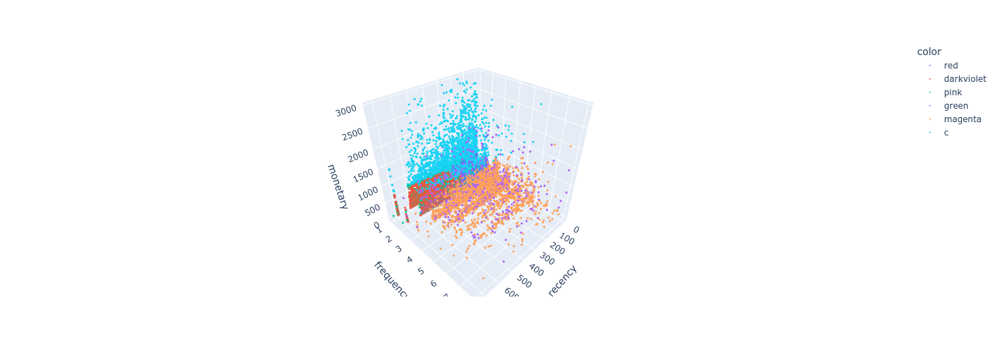

<Figure size 864x576 with 0 Axes>

In [82]:
# Plot 3D orientable
plt.figure(figsize=(12, 8))
colors = {0: 'red', 1: 'c', 2: 'magenta', 3: 'green', 4: 'darkviolet', 5: 'pink'}

fig = px.scatter_3d(data_rfm_3_scaled_inversed, x='recency',
                    y='frequency',
                    z='monetary',
                    color=data_rfm_3_scaled_inversed['Cluster'].apply(lambda x: colors[x]),
                    width=800,
                    height=500)

fig.update_traces(marker_size=1)

In [83]:
# Score silhouette
print(f"Le score silhoutte est {round(metrics.silhouette_score(data_rfm_3_scaled, data_rfm_3_scaled['Cluster']), 3)}")

Le score silhoutte est 0.61


/home/agent/Logiciels/anaconda3/lib/python3.9/site-packages/sklearn/manifold/_mds.py:506: UserWarning:

The MDS API has changed. ``fit`` now constructs an dissimilarity matrix from data. To use a custom dissimilarity matrix, set ``dissimilarity='precomputed'``.



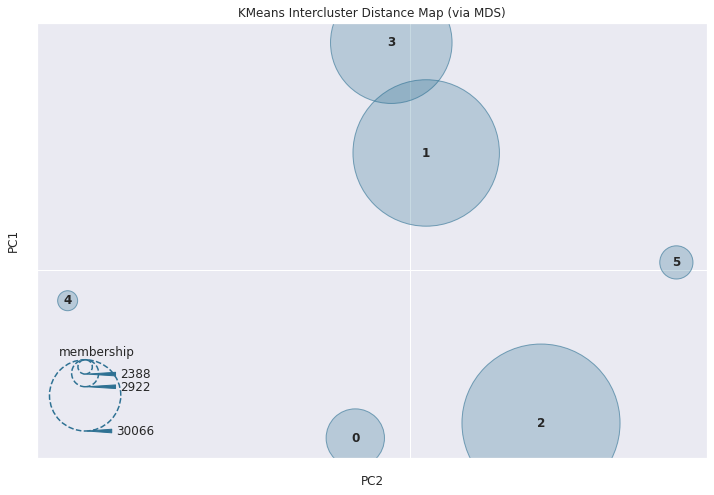

InterclusterDistance(ax=<AxesSubplot:title={'center':'KMeans Intercluster Distance Map (via MDS)'}, xlabel='PC2', ylabel='PC1'>,
                     estimator=KMeans(n_clusters=6, random_state=0))

In [84]:
# Visualisation des clusters en 2D via Yellowbrick
plt.figure(figsize=(12, 8))
intercluster_distance(KMeans(n_clusters=6, init='k-means++', random_state=0), data_rfm_3_scaled)

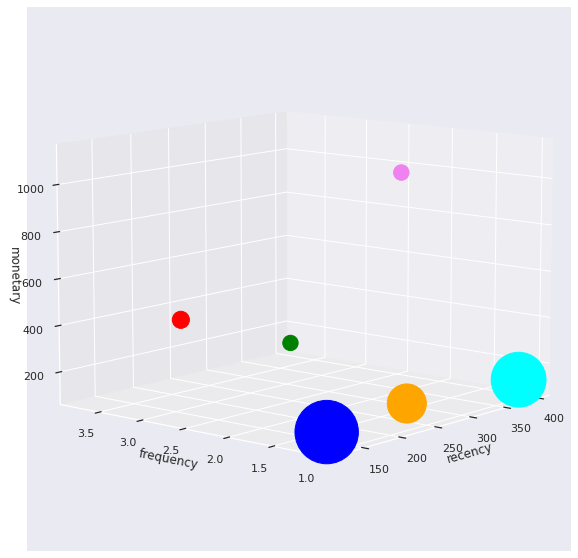

In [85]:
# Graphique avec centroïds pour la présentation
cluster = data_rfm_3_scaled_inversed.groupby('Cluster').mean()
cluster_count = data_rfm_3_scaled_inversed.groupby('Cluster').count()
cluster_count['somme'] = cluster_count['recency'] + cluster_count['frequency'] + cluster_count['monetary']

colors_4 = ['blue', 'violet', 'red', 'green', 'cyan', 'orange']
sns.set()
plt.figure(figsize=(10, 10))
ax = plt.axes(projection='3d')
ax.scatter3D(cluster['recency'].values, cluster['frequency'].values, cluster['monetary'].values,
             c=colors_4,
             s=cluster_count['somme']/30,
             marker='o',
             alpha=1
             )

ax.set_xlabel('recency')
ax.set_ylabel('frequency')
ax.set_zlabel('monetary')

ax.view_init(10, -140)

### Export des données 

In [86]:
# Export des données pour Réaliser DBScan et HAC dans un autre notebook
rfm_3.to_csv("rfm_3.csv", index=False)

Conclusion :  
Avant DBScan et HAC, notre meilleur modèle est avec celui avec 5 features et 6 clusters :
- Recency
- Monetary
- Frequency
- Note client
- Nombre moyen de paiements    